## Лабораторная работа 8.
### Текстурный анализ и контрастирование

ФИО: Монастырный Максим Александрович

Группа: М24-501 

In [1]:
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from PIL import Image

In [2]:
sns.set_theme()

In [3]:
MAX_UINT8 = 255
DATA_DIR = Path("../data/contrast")
OUTPUT_DIR = DATA_DIR / "results"
OUTPUT_DIR.mkdir(exist_ok=True, parents=True)

Исходное изображение

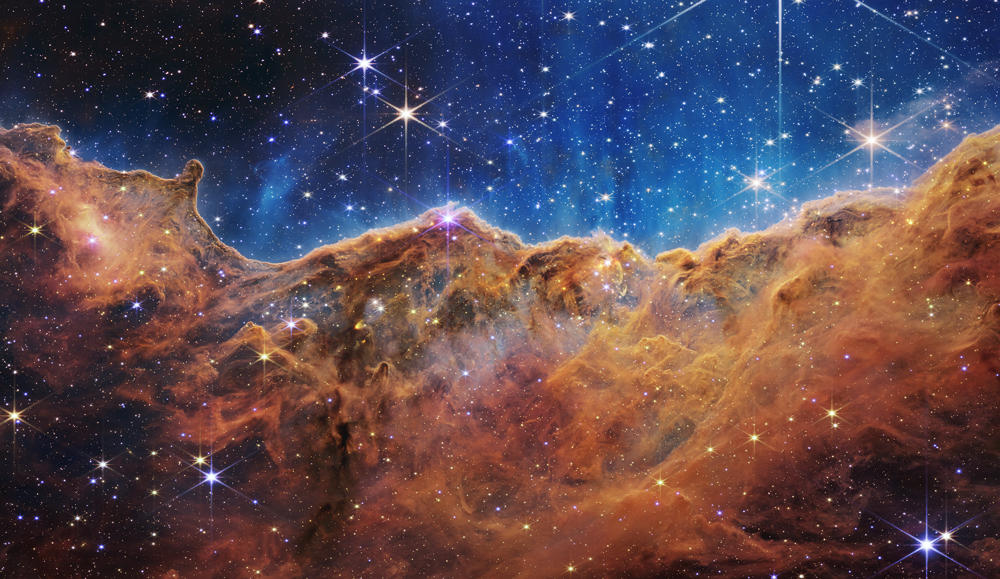

In [4]:
image_path = DATA_DIR / "test_image.png"
raw_image = Image.open(image_path)
source_image = np.array(raw_image)
raw_image

Конвертации между пространствами

In [5]:
def rgb2hsl(image: np.ndarray) -> np.ndarray:
    """Converts an RGB image to HSL representation.

    The input image should be a NumPy array with shape (N, M, 3),
    where the last dimension represents the RGB channels.
    The output image will be a NumPy array with shape (N, M, 3)
    where the first dimension represents the HSL channels (Hue, Saturation, Lightness).

    Args:
        image (np.ndarray): The input RGB image.

    Raises:
        ValueError: If the input image does not have the shape (N, M, 3).

    Returns:
        np.ndarray: The converted HSL image.
    """

    if len(image.shape) != 3 or image.shape[2] != 3:
        raise ValueError(
            "Input image must have shape (N, M, 3), ",
            f"but got {image.shape}",
        )

    # normalize image first
    rgb_image = image / MAX_UINT8

    value = np.max(rgb_image, axis=-1)
    chroma = value - np.min(rgb_image, axis=-1)

    # calculate L part
    l_part = value - chroma / 2

    # calculate H part
    h_part = np.zeros_like(l_part)

    brg_image = np.array(
        [rgb_image[..., 2], rgb_image[..., 0], rgb_image[..., 1]]
    ).transpose(1, 2, 0)

    # ((b-r), (r-g), (g-b))
    diff_image = brg_image - rgb_image

    non_zero = chroma > 0

    mask_r = non_zero & (value == rgb_image[..., 0])
    h_part[mask_r] = 60.0 * np.mod(diff_image[mask_r, 2] / chroma[mask_r], 6)

    mask_g = non_zero & (value == rgb_image[..., 1])
    h_part[mask_g] = 60.0 * (diff_image[mask_g, 0] / chroma[mask_g] + 2)

    mask_b = non_zero & (value == rgb_image[..., 2])
    h_part[mask_b] = 60.0 * (diff_image[mask_b, 1] / chroma[mask_b] + 4)

    # calculate S part
    s_part = np.zeros_like(l_part)

    region = (l_part != 0.0) & (l_part != 1.0)
    s_part[region] = chroma[region] / (
        1 - np.abs(2 * value[region] - chroma[region] - 1)
    )

    converted_image = np.array([h_part, s_part, l_part]).transpose(1, 2, 0)
    return converted_image

In [6]:
def hsl2rgb(image: np.ndarray) -> np.ndarray:
    """Convert an HSL image to RGB.

    Args:
        image (numpy.ndarray): Input HSL image as a NumPy array of shape (H, W, 3).
            Channels: H (degrees, any real, will be reduced modulo 360),
                      S (0..1),
                      L (0..1).

    Returns:
        numpy.ndarray: RGB image as a NumPy array of shape (H, W, 3) with dtype uint8
        and values in [0, 255].
    """
    h = image[..., 0]
    s = image[..., 1]
    l = image[..., 2]

    h = np.mod(h, 360.0)

    rgb = np.zeros(shape=(h.shape[0], h.shape[1], 3))

    chroma = (1 - np.abs(2 * l - 1)) * s
    h_divided = h / 60.0
    x = chroma * (1 - np.abs(np.mod(h_divided, 2) - 1))
    m = l - chroma / 2

    regions = [(h_divided >= i) & (h_divided < i + 1) for i in range(6)]

    matches_c = [
        (1, 0, 0),
        (0, 1, 0),
        (0, 1, 0),
        (0, 0, 1),
        (0, 0, 1),
        (1, 0, 0),
    ]

    matches_x = [
        (0, 1, 0),
        (1, 0, 0),
        (0, 0, 1),
        (0, 1, 0),
        (1, 0, 0),
        (0, 0, 1),
    ]

    for region, match_c, match_x in zip(regions, matches_c, matches_x):
        index_c = np.argmax(np.array(match_c))
        index_x = np.argmax(np.array(match_x))

        rgb[region, index_c] = chroma[region]
        rgb[region, index_x] = x[region]

    rgb += m[..., np.newaxis]
    rgb = np.clip(rgb, 0.0, 1.0)

    rgb_uint8 = (rgb * MAX_UINT8).round().astype(np.uint8)
    return rgb_uint8

In [7]:
# Проверка правильности работы
(source_image == hsl2rgb(rgb2hsl(source_image))).all()

True

Методы для текстурного анализа и контрастирования

In [8]:
def equalize_histogram_gray(img_gray: np.ndarray) -> np.ndarray:
    """
    Equalizes the histogram of a grayscale image.

    Args:
        img_gray (np.ndarray): Grayscale image as a NumPy array.

    Returns:
        np.ndarray: Equalized grayscale image as a NumPy array.
    """
    if img_gray.dtype != np.uint8:
        img_gray = (img_gray.clip(0, MAX_UINT8)).astype(np.uint8)

    hist, _ = np.histogram(
        img_gray.ravel(), bins=MAX_UINT8 + 1, range=(0, MAX_UINT8 + 1)
    )
    cdf = hist.cumsum()
    cdf_normalized = (cdf - cdf.min()) * MAX_UINT8 / (cdf.max() - cdf.min())
    cdf_normalized = cdf_normalized.astype(np.uint8)

    eq_img = cdf_normalized[img_gray]
    return eq_img

In [9]:
def compute_lbp(image: np.ndarray, radius: int = 1, n_points: int = 8) -> np.ndarray:
    """
    Computes the Local Binary Pattern (LBP) for a grayscale image (without padding - edges are cropped).

    Args:
        image (np.ndarray): Grayscale image as a 2D NumPy array.
        radius (int): Radius of the circle for neighbor sampling.
        n_points (int): Number of points to sample on the circle.

    Returns:
        np.ndarray: LBP image as a 2D NumPy array.
    """
    if image.ndim == 3:
        raise ValueError("Expected grayscale image (2D array).")
    if image.dtype != np.uint8:
        image = image.astype(np.uint8)

    h, w = image.shape
    pad = radius

    angles = 2 * np.pi * np.arange(n_points) / n_points
    dx = np.round(radius * np.cos(angles)).astype(int)
    dy = np.round(-radius * np.sin(angles)).astype(int)

    center_image = image[pad : h - pad, pad : w - pad]

    lbp = np.zeros_like(center_image, dtype=np.uint8)

    for p in range(n_points):
        ni_start = pad + dy[p]
        ni_end = h - pad + dy[p]
        nj_start = pad + dx[p]
        nj_end = w - pad + dx[p]

        neighbor_image = image[ni_start:ni_end, nj_start:nj_end]
        comparison = neighbor_image >= center_image
        binary_value = comparison.astype(np.uint8)
        weight = np.uint8(1 << (n_points - 1 - p))
        lbp |= binary_value * weight

    return lbp

In [10]:
def get_normalized_histogram(
    img_gray: np.ndarray, bins: int = MAX_UINT8 + 1
) -> np.ndarray:
    """
    Computes the normalized histogram of a grayscale image.

    Args:
        img_gray (np.ndarray): Grayscale image as a NumPy array.
        bins (int): Number of histogram bins.

    Returns:
        np.ndarray: Normalized histogram as a NumPy array.
    """
    hist, _ = np.histogram(img_gray.ravel(), bins=bins, range=(0, bins))
    return hist / hist.sum()

In [11]:
def entropy(hist: np.ndarray) -> float:
    """
    Computes the entropy of a histogram.

    Args:
        hist (np.ndarray): Histogram as a NumPy array.

    Returns:
        float: Entropy value.
    """
    hist_filtered = hist[hist > 0]
    return -np.sum(hist_filtered * np.log2(hist_filtered))


def dominant_patterns(hist: np.ndarray, top_k: int = 5) -> np.ndarray:
    """
    Identifies the top-k dominant patterns in a histogram.
    Args:
        hist (np.ndarray): Histogram as a NumPy array.
        top_k (int): Number of top patterns to return.

    Returns:
        np.ndarray: Indices of the top-k dominant patterns.
    """
    return np.argsort(hist)[-top_k:][::-1]

Проверка на тестовом изображении

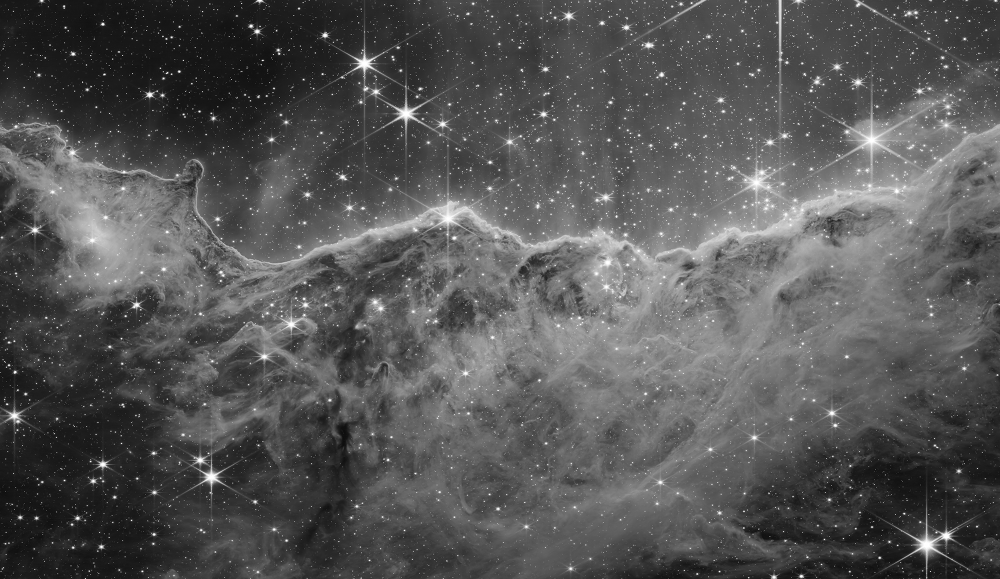

In [12]:
hsl_image = rgb2hsl(source_image)
l_channel = (hsl_image[..., 2] * MAX_UINT8).astype(np.uint8)

Image.fromarray(l_channel).save(OUTPUT_DIR / "l_channel.png")
Image.open(OUTPUT_DIR / "l_channel.png")

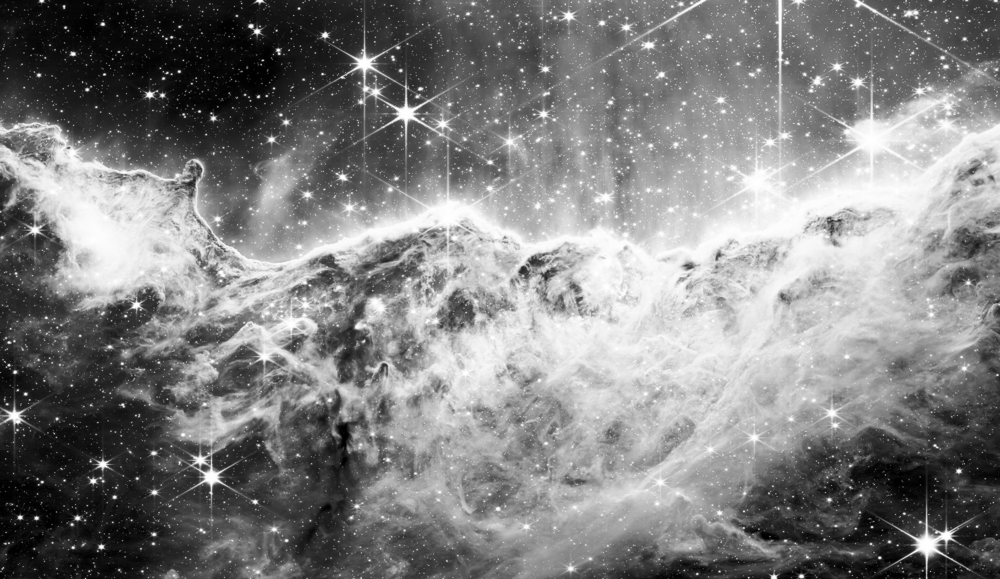

In [13]:
l_equalized = equalize_histogram_gray(l_channel)

Image.fromarray(l_equalized).save(OUTPUT_DIR / "l_equalized.png")
Image.open(OUTPUT_DIR / "l_equalized.png")

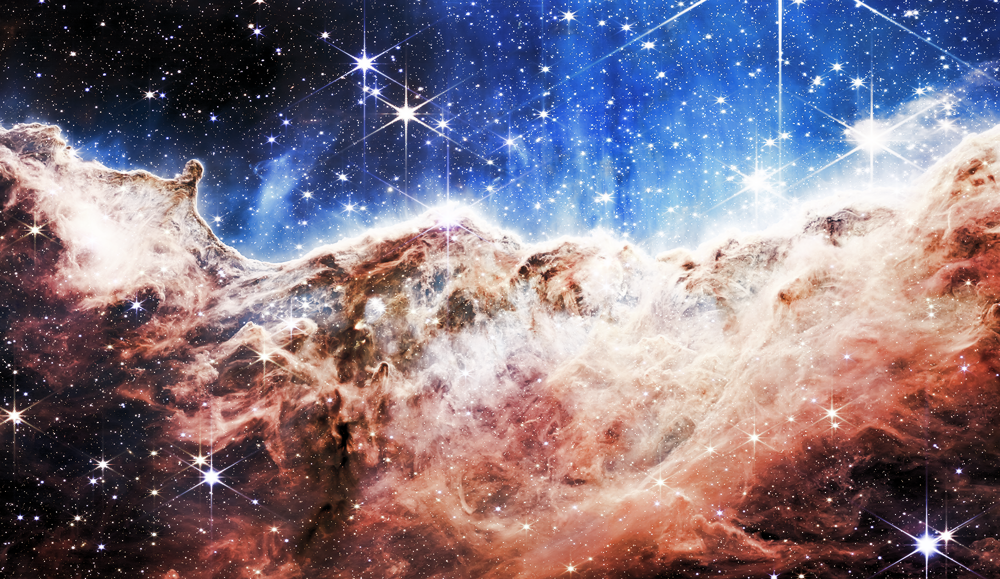

In [14]:
hsl_equalized = hsl_image.copy()
hsl_equalized[..., 2] = l_equalized / MAX_UINT8
rgb_equalized = hsl2rgb(hsl_equalized)

Image.fromarray(rgb_equalized).save(OUTPUT_DIR / "rgb_equalized.png")
Image.open(OUTPUT_DIR / "rgb_equalized.png")

In [15]:
hist_source = get_normalized_histogram(l_channel)
hist_equalized = get_normalized_histogram(l_equalized)

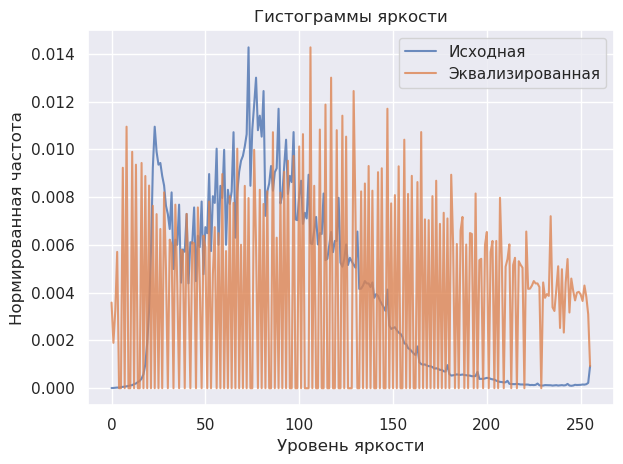

In [16]:
plt.plot(hist_source, label="Исходная", alpha=0.8)
plt.plot(hist_equalized, label="Эквализированная", alpha=0.8)
plt.xlabel("Уровень яркости")
plt.ylabel("Нормированная частота")
plt.legend()
plt.title("Гистограммы яркости")
plt.grid(True)
plt.tight_layout()
plt.savefig(OUTPUT_DIR / "brightness_histograms.png", dpi=150, bbox_inches="tight")
plt.show()

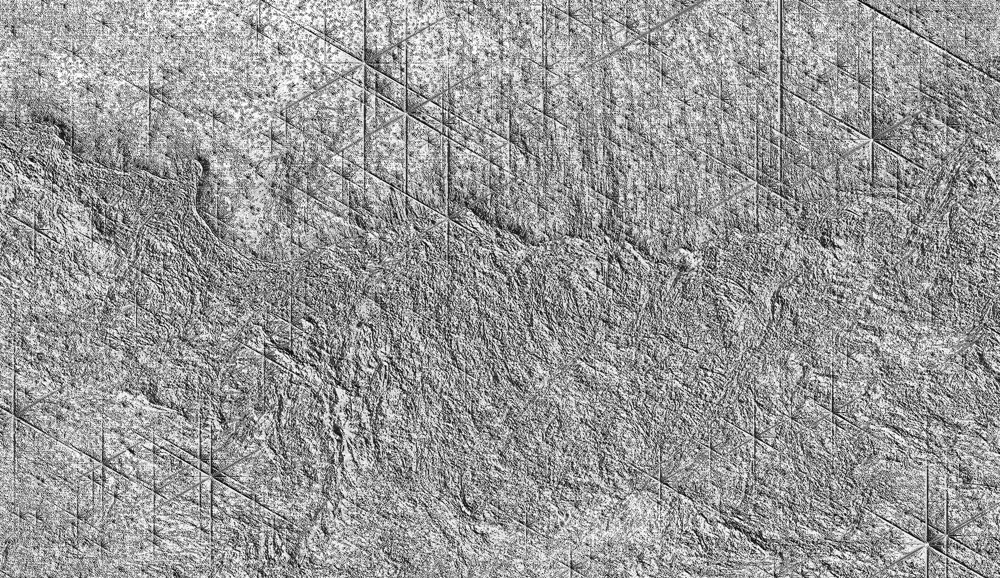

In [17]:
lbp_source = compute_lbp(l_channel)

Image.fromarray(lbp_source).save(OUTPUT_DIR / "lbp_source.png")
Image.open(OUTPUT_DIR / "lbp_source.png")

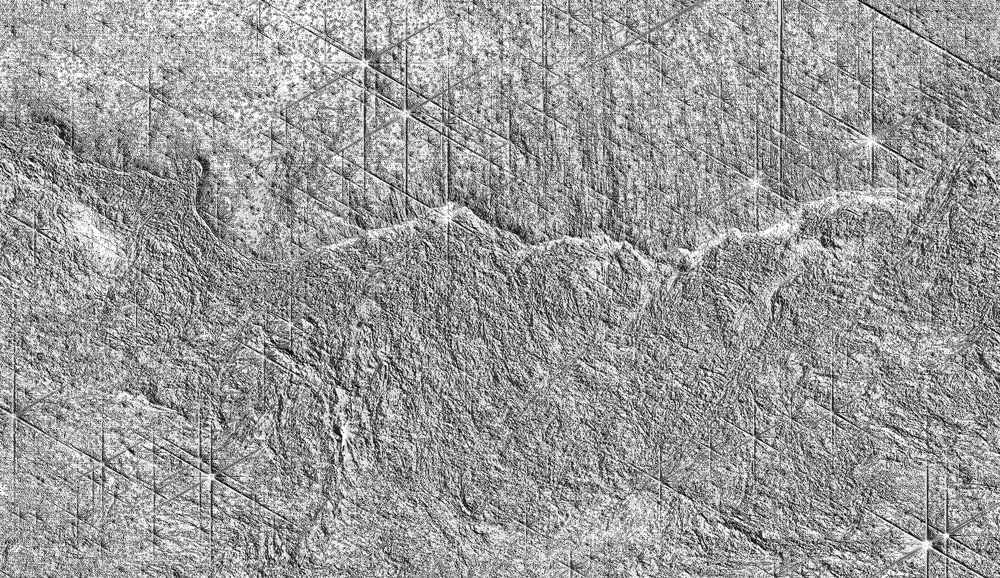

In [18]:
lbp_equalized = compute_lbp(l_equalized)

Image.fromarray(lbp_equalized).save(OUTPUT_DIR / "lbp_equalized.png")
Image.open(OUTPUT_DIR / "lbp_equalized.png")

In [19]:
hist_lbp_source = get_normalized_histogram(lbp_source)
hist_lbp_equalized = get_normalized_histogram(lbp_equalized)

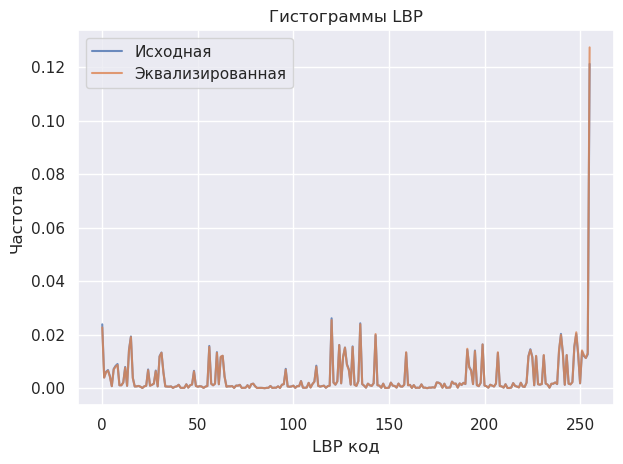

In [20]:
plt.plot(hist_lbp_source, label="Исходная", alpha=0.8)
plt.plot(hist_lbp_equalized, label="Эквализированная", alpha=0.8)
plt.xlabel("LBP код")
plt.ylabel("Частота")
plt.legend()
plt.title("Гистограммы LBP")
plt.grid(True)
plt.tight_layout()
plt.savefig(OUTPUT_DIR / "lbp_histograms.png", dpi=150, bbox_inches="tight")
plt.show()

LBP вроде как инвариантно к монотонным изменениям яркости, поэтому гистограммы LBP для исходного и контрастированного изображений совпадают.

In [21]:
entropy_source = entropy(hist_lbp_source)
entropy_equalized = entropy(hist_lbp_equalized)

entropy_source, entropy_equalized

(6.493039528944879, 6.466796863801832)

In [22]:
mean_source = hist_lbp_source.mean()
mean_equalized = hist_lbp_equalized.mean()

mean_source, mean_equalized

(0.0039062499999999996, 0.0039062499999999996)

In [23]:
std_source = hist_lbp_source.std()
std_equalized = hist_lbp_equalized.std()

std_source, std_equalized

(0.009034442703656794, 0.00933365351165259)

In [24]:
dom_source = dominant_patterns(hist_lbp_source, 5)

dom_source

array([255, 120, 135,   0, 248])

In [25]:
dom_equalized = dominant_patterns(hist_lbp_equalized, 5)

dom_equalized

array([255, 120, 135,   0, 248])